# 디즈니 캐릭터 분류 모델

# fastai(v2) 라이브러리 설치
아래 두 줄의 명령어의 실행이 완료된 다음, 반드시 런타임을 재시작 해야함
- 방법: 런타임 메뉴(Runtime) => 런타임 재시작 클릭(Restart runtime)

In [ ]:
!git clone https://github.com/fastai/fastai
!pip install -e "fastai[dev]"

# fastai 버전확인
대부분의 Python 패키지는 `__version__` 속성을 가지고 있는데, 이 속성에 접근하면 현재 설치된 패키지의 버전 정보를 확인할 수 있음.

아래 코드의 실행 결과가 `2.x.x` 가 아니라, `1.x.x` 라면, fastai v2의 설치가 정상적으로 되지 않은것임. 따라서, 이전 과정을 다시한번 수행/검토해볼 필요가 있음. 

In [ ]:
import fastai
fastai.__version__

2.0.7


# fastbook 제공, 유틸리티 라이브러리 설치

마이크로소프트 Bing 검색엔진을 통한 이미지 검색 등의 라이브러리는 fastai 차원에서 제공하는 일반화된 라이브러리가 아님. 다만, 책 내용의 실습을 위해서 fastbook 저장소에서 별도로 작성되어 제공되는것임.

만약, 책 실습 외의 상황에서도 `search_images_bing` 등의 API를 사용하고 싶다면, 반드시 아래 코드를 실행하여 `fastbook` 패키지를 import 해 줘야함.

fastbook의 유틸리티 함수로서 작성된 함수의 목록은 다음과 같음.
- `search_images_bing`
- `plot_function`
- `draw_tree`
- `cluster_columns`

딱히 구현상 어려운 수준의 함수는 아니므로, 참고하여 직접 구현해도 됨.

In [ ]:
!pip install -Uqq fastbook
import fastbook

# 필요한 모든 라이브러리를 import

In [ ]:
from fastbook import *
from fastai.vision.all import *
from fastai.vision.widgets import *

# Bing 으로부터 이미지 다운로드 및 데이터셋 구축

## Azure Cognitive Service API 키 값

API 키를 얻어오기 위해서는
1. 일단 MS Azure에 가입이 되어 있어야함
  - 계정이 없다면 [가입](https://azure.microsoft.com/ko-kr/free/search/?&ef_id=Cj0KCQjwhb36BRCfARIsAKcXh6E9kaHAp8Mdh_DyYqcheUhZiXkBr3gY3v4D4B-P9YHukHcJO0yJ4_saAtcLEALw_wcB:G:s&OCID=AID2100068_SEM_Cj0KCQjwhb36BRCfARIsAKcXh6E9kaHAp8Mdh_DyYqcheUhZiXkBr3gY3v4D4B-P9YHukHcJO0yJ4_saAtcLEALw_wcB:G:s&gclid=Cj0KCQjwhb36BRCfARIsAKcXh6E9kaHAp8Mdh_DyYqcheUhZiXkBr3gY3v4D4B-P9YHukHcJO0yJ4_saAtcLEALw_wcB) 링크에 접속한 후, "체험 계정 만들기" 버튼을 클릭해서 계정을 생성해야함
  - 계정이 있다면, 단순히 로그인만 해 주면 됨

2. MS Azure 계정이 있다면, 로그인 후 [Azure Portal](https://portal.azure.com/)에 접속해 줘야함
  - 상단의 검색 바에서 "Cognitive Services"를 타이핑한 다음, 검색된 결과를 클릭함 (당연히 Cognitive Services 라는걸 클릭 해야함)
  - +New 버튼을 클릭
  - Marketplace에서, "Bing Search"를 검색하여 클릭
  - "Create" 버튼을 클릭
  - 각종 정보 입력. 단, "Pricing Tier"에는 반드시 "무료인 것을 선택"
    - Resource Group이 없는 경우, 텍스트박스 하단의 "New Group"을 클릭하여 하나 생성
  
3. 생성된 Bing Search 를 클릭
  - 좌측 메뉴의 "Keys and Endpoint"를 선택
  - "Show Keys" 버튼을 클릭하여, 숨김표시된 Key 값을 풀어줌
  - Key1 을 복사하여, 아래의 `key` 값에 넣어줌

In [ ]:
key = '당신만의 Azure Cognitive Service (Bing Search) API Key를 넣어주세요'

## 이미지 다운로드

몇 가지 알아두면 좋을만한 정보의 나열
- `Path`는 fastai에서 개발한 `fastcore`에 포함된 기초 라이브러리로, 기본적으로는 Python에서 표준적으로 제공하는 `pathlib.Path`를 확장한 것임. 
  - `pathlib.Path`의 기능을 모두 그대로 사용 가능하지만, 여기에 다음의 몇 가지 편의 사항을 추가함.
    - `.readlines()`
    - `.read()` 
    - `.write()` 
    - `.save()` 
    - `.load()`
    - `.ls()`

- `search_images_bing` 함수를 이용하여, URL 목록을 가져옴. 
  - Azure Cognitive Service API Key 및 검색하고자 하는 키워드를 파라미터로서 제공 해 줘야함. 
  - 이 함수가 반환하는 객체는 Python의 표준 객체인 list를 확장한 L 이라는 객체임 (fastcore)

- `download_images` 함수를 이용하여, 준비된 URL 목록의 모든 이미지를 다운로드함. 
  - 정확히는 results가 URL 목록은 아니며, Bing Search Service가 반환한 JSON 포맷의 내용임. 
  - L 객체는 attrgot 이라는 메서드를 제공하는데, 리스트에 포함된 모든 아이템으로부터 인자로 지정된 속성의 값들만을 추출하여, 별도의 리스트(L)을 반환함. 
  - 첫 번째 인자인 dest가 이미지 다운로드 후 저장될 위치임



In [ ]:
# 아래 한줄의 코드는 일종의 리스트를 만들어줌 (정확히는 Tuple)
disney_characters = 'disney malificent', 'disney cinderella', 'disney jasmin', 'disney mulan', 'disney belle', 'disney pocahontas'
path = Path('disney')

# 최상위 디렉토리의 생성
if not path.exists():
  path.mkdir()

# 각 이미지 클래스 별로 반복하여 접근
for character in disney_characters:
  # 클래스 이름의 Path 지정 및 생성
  dest = (path/character)
  dest.mkdir(exist_ok=True)

  # search_images_bing 함수를 이용하여, URL 목록을 가져옴
  results = search_images_bing(key, character)

  # download_images 함수를 이용하여, 준비된 URL 목록의 모든 이미지를 다운로드함
  download_images(dest, urls=results.attrgot('content_url'))

## 모든 이미지파일의 Path 목록
fastai에서 제공하는 `get_image_files`는 지정된 `Path`를 기점으로, 하위에 포함된 모든 이미지 목록을 재귀적으로 검색하여 들고옴

구분없이 몽땅 들고오는 이유는 다음과 같음
- 다운로드된 이미지는 폴더이름 단위로 클래스가 구분됨
  - 이후 `DataBlock` 또는 `ImageDataLoaders` 객체 생성시 클래스(레이블)을 구분해내기 위한 로직 추가가 가능함. 구분하는 별도의 함수를 만들게 되며, 단순히 규칙을 지정해 주기만 하면됨.

아래 코드의 실행결과는 `fnames` 객체 내용을 출력해줌
- 출력 결과의 앞 부분 (#...)은 리스트에 포함된 아이템의 개수를 의미함. 원래 표준 list 객체는 이러한 정보를 출력하지 않으나, L은 출력해 주는 특성이 있음.

In [ ]:
fnames = get_image_files(path)
fnames

(#899) [Path('disney/disney mulan/00000005.jpg'),Path('disney/disney mulan/00000040.jpg'),Path('disney/disney mulan/00000122.jpg'),Path('disney/disney mulan/00000104.png'),Path('disney/disney mulan/00000068.jpg'),Path('disney/disney mulan/00000031.jpeg'),Path('disney/disney mulan/00000058.jpg'),Path('disney/disney mulan/00000071.jpg'),Path('disney/disney mulan/00000138.jpg'),Path('disney/disney mulan/00000091.jpg')...]

## 망가진 링크의 이미지 검사하여, 그 목록을 삭제하기

In [ ]:
failed = verify_images(fnames)
failed

(#9) [Path('disney/disney mulan/00000032.jpg'),Path('disney/disney belle/00000128.jpg'),Path('disney/disney belle/00000037.jpg'),Path('disney/disney jasmin/00000123.jpg'),Path('disney/disney jasmin/00000011.png'),Path('disney/disney pocahontas/00000087.jpg'),Path('disney/disney pocahontas/00000019.jpg'),Path('disney/disney malificent/00000098.jpeg'),Path('disney/disney malificent/00000073.jpg')]

`L` 객체에는 함수형 언어적 기능인 `map` 메서드가 구현되어 있음. `map` 메서드의 파라미터는 어떤 함수가 지정될 수 있음. 

`map` 메서드가 호출되는 순간, 각 아이템을 반복적으로 접근하면서, 제공된 함수를 각 아이템에 적용하여 반환된 결과를 싸그리 모아서 새로운 `L` 객체를 만들어줌.

`Path.unlink` 라는 함수가 하는일은 `failed` 에 포함된 모든 아이템 (`Path`)에 대하여, 파일을 삭제하는일을 수행함. `Path.unlink`는 Python의 표준 라이브러리임.

In [ ]:
failed.map(Path.unlink)

## DataBlock의 생성

- DataBlock은 DataLoaders를 만들기 위한 저수준의 API. 각 인자가 가지는 의미는
  - blocks: Block의 리스트. Block은 데이터를 표현하는 수단
    - 두 개 이상의, 여러개의 `Block`을 지정하는것도 가능함. 단, 이때는 `n_inp` 라는 파라미터의 값을 조절하여, 입력으로 사용될 Block이 몇 개인지를 지정해 줘야만 함. 예를 들어서 `blocks=(ImageBlock, BBoxBlock, BBoxLblBlock)` 처럼 설정했는데 그 중 첫번째만을 입력으로 삼고 싶다면, `n_inp=1` 이라고 지정해 줘야하만함.
    - 이미지처리 관련, 정의된 Block은 다음과 같은것들이 있음. 기본적으로 모두, `TransformBlock` 인스턴스를 반환함. `TransformBlock`은 단순히, `type_tfms, item_tfms, batch_tfms, dl_type, dls_kwargs` 내용들을 잡아두기 위한 Wrapper 클래스임.
      - `ImageBlock`
      - `MaskBlock`
      - `PointBlock`
      - `BBoxBlock`
      - `BBoxLblBlock`
  - get_items: 데이터를 가져오기 위한 함수를 지정
    - `DataBlock` 생성 후, `DataLoaders`를 반환받기 위해서, `dataloaders()`라는 메서드를 사용하게 됨. `dataloaders()` 메서드에는 경로(Path)를 지정해 주게 되어 있는데, 이 경로를 기반으로 get_items의 행동이 결정됨.
    - 가령 아래처럼 `get_image_files`를 지정하면, `dataloaders(path)` 메서드 호출시, `path` 밑에 딸린 모든 이미지를 긁어오게됨
  - splitter: 데이터를 학습/검증으로 분리해내기 위한 수단을 지정
    - 다양한 Splitter 클래스가 존재함
      - `RandomSplitter`
      - `TrainTestSplitter`
      - `IndexSplitter`
      - `GrandparentSplitter`
      - `FuncSplitter`
      - `MaskSplitter`
      - `FileSplitter`
      - `ColSplitter`
      - `RandomSubsetSplitter`
    - 경우에 따라서, 데이터셋이 미리 train/valid 와 같은 디렉토리로 나뉘어져 제공되는 경우가 있음. 
      - 이 때는 splitter에 할당되는 객체의 `valid_pct`값을 지정하지 않으면 됨. 그러면 자동으로 `train` 및 `valid`라는 이름의 디렉토리를 대상으로 삼음. 즉, 다른 이름의 디렉토리라면, 이 이름을 `train` 및 `valid` 라는 이름으로 맞춰줘야함.    
  - get_y: 레이블을 지정하는 수단을 지정
    - blocks의 출력 개수가 여러개 될 수 있듯이, get_y 또한 여러개가 지정될 수 있다. 이 경우는 리스트에 두 개의 함수를 포함시켜주면 됨.
    - 기본 제공 parent_label은 단순히, 부모 디렉토리명을 레이블로 보겠다는 뜻이된다.
    - RegexLabeller도 기본제공되는데 regex 기반으로 레이블을 지정할 수 있어서, 매우 강력함.
  - item_tfms: 각 아이템 별 데이터 변형
    - 보통 이미지의 경우, Resize를 해줌
    - 왜 Resize를 batch_tfms에서 해주지 않는가 하면, 이미지의 크기가 모두 제각각이기 때문임. GPU는 동일한 크기, 동일한 연산을 동시 다발적 (배치 단위)으로 단순히 계산하는데 최적화 되어 있음. 따라서, 모두 제각각인 이미지를 일단 최초에 동일한 크기로 맞추는 작업은 개별적으로 CPU에서 수행될 필요가 있음.
    
  - batch_tfms: 배치단위의 데이터 변형
    - item_tfms에서 모두 동일한 크기로 맞춰지거나, 쨋든 GPU에서 배치단위로 계산되기에 최적화된 데이터 묶음에 대하여, 묶음 형태의 데이터 변형을 가한다.
    - 여러가지 변형 방법이 기술될 수 있지만, `aug_transforms` 를 사용하는것이 초반에는 선호됨. 다양한 데이터 증강 기법들이 모두 포함되어 있음. 
      - [링크](https://docs.fast.ai/vision.augment#aug_transforms)를 확인해 볼것
      
- 약간 상위레벨에서 보자면, 크게 세 종류의 변형(Transform)이 일어남
  - Type Transform
    - blocks 인자를 통해서, 입력/출력에 대한 Type 변형
  - Item Transform
    - item_tfms 인자를 통해서, 각 아이템별 데이터 변형
  - Batch Transform
    - batch_tfms 인자를 통해서, 배치단위의 데이터 변형

In [ ]:
disney_characters = DataBlock(
                      blocks=(ImageBlock, CategoryBlock),
                      get_items=get_image_files,
                      splitter=RandomSplitter(valid_pct=0.2, seed=42),
                      get_y=parent_label,
                      item_tfms=Resize(128),
                      batch_tfms=aug_transforms(mult=2.0, size=224))

DataBlock의 인자 중 blocks에 할당되는 값들의 정체가 궁금할 것임. 간단한 ImageBlock과 CategoryBlock을 통해서 이들이 무엇인지 살펴봄.

1. ImageBlock
```python
def ImageBlock(cls=PILImage):
    "A `TransformBlock` for images of `cls`"
    return TransformBlock(type_tfms=cls.create, batch_tfms=IntToFloatTensor)
```
  - TransformBlock을 반환하는데, `type_tfms` 및 `batch_tfms` 인자의 값을 지정해주었음
  - 약간 혼란이 올 수 있는 부분은 cls인데, PILImage가 PIL의 Image와는 다른것임. fastai에서 Image 클래스를 확장한 것으로, create라는 별도의 메서드가 추가됨. 
```python
class PILBase(Image.Image, metaclass=BypassNewMeta):
    _bypass_type=Image.Image
    _show_args = {'cmap':'viridis'}
    _open_args = {'mode': 'RGB'}
    @classmethod
    def create(cls, fn:(Path,str,Tensor,ndarray,bytes), **kwargs)->None:
        "Open an `Image` from path `fn`"
        if isinstance(fn,TensorImage): fn = fn.permute(1,2,0).type(torch.uint8)
        if isinstance(fn, TensorMask): fn = fn.type(torch.uint8)
        if isinstance(fn,Tensor): fn = fn.numpy()
        if isinstance(fn,ndarray): return cls(Image.fromarray(fn))
        if isinstance(fn,bytes): fn = io.BytesIO(fn)
        return cls(load_image(fn, **merge(cls._open_args, kwargs)))

    def show(self, ctx=None, **kwargs):
        "Show image using `merge(self._show_args, kwargs)`"
        return show_image(self, ctx=ctx, **merge(self._show_args, kwargs))
```
    - 보다시피 create가 하는일은 여러종류의 입력 type이 들어올 수 있다는것을 가정한 후, 이들을 적절한 형태로서 통일화된 결과로 맞춰주기위한 변화작업임. 느낌적으로? numpy 형식으로 변환해 주는것 같음.
    - TransformBlock의 batch_tfms는 필수요건이 아님. 단, 여기에 Transform하려는 오퍼레이션이 설정된 경우, DataBlock 정의시 전달된 batch_tfms과 merge되어서 결국은 한 뭉떵이가 됨.
```python
...
self.default_batch_tfms = _merge_tfms(*blocks.attrgot('batch_tfms', L()))
...
self.new(item_tfms, batch_tfms)
...
def new(self, item_tfms=None, batch_tfms=None):
    self.item_tfms  = _merge_tfms(self.default_item_tfms,  item_tfms)
    self.batch_tfms = _merge_tfms(self.default_batch_tfms, batch_tfms)
    return self
```

2. CategoryBlock
```python
def CategoryBlock(vocab=None, sort=True, add_na=False):
    "`TransformBlock` for single-label categorical targets"
    return TransformBlock(type_tfms=Categorize(vocab=vocab, sort=sort, add_na=add_na))
```

  - 이번에는 type_tfms로 지정된 것이 Categorize 라는 클래스 인스턴스임
```python
class Categorize(DisplayedTransform):
    "Reversible transform of category string to `vocab` id"
    
    loss_func, order, store_attrs = CrossEntropyLossFlat() , 1 , 'vocab,add_na'
    
    def __init__(self, vocab=None, sort=True, add_na=False):
        store_attr(self, self.store_attrs+',sort')
        self.vocab = None if vocab is None else CategoryMap(vocab, sort=sort, add_na=add_na)

    def setups(self, dsets):
        if self.vocab is None and dsets is not None: 
            self.vocab = CategoryMap(dsets, sort=self.sort, add_na=self.add_na)
        self.c = len(self.vocab)

    def encodes(self, o): return TensorCategory(self.vocab.o2i[o])
    def decodes(self, o): return Category      (self.vocab    [o])
```
    - 

## DataLoaders 생성

DataBlock은 "어떻게 어떻게 데이터를 구성하겠다" 라는 일종의 선언문같은것임. 이것이 실제 적용된 결과를 얻기위해서는, DataBlock에 실제 데이터의 정보를 흘려보내줄 필요가 있음. DataBlock에는 dataloaders 라는 메서드가 있는데, 이 메서드에 이미지들이 들어있는 경로를 지정해 주면됨. 

In [ ]:
dls = disney_characters.dataloaders(path)

`show_batch` 메서드는 training 데이터셋에 포함된 데이터 중 일부를 랜덤하게 출력해줌. 다음과 같은 파라미터로 구성될 수 있음.
```python
TfmdDL.show_batch(b=None, max_n=9, ctxs=None, show=True, unique=False, **kwargs)
```

`max_n` 값의 설정에 따라서, 출력되는 이미지의 개수를 정할 수 있음. 출력 대상이 될 데이터셋은 `train_ds`, `valid_ds`로서 접근이 가능함.
`dls.valid_ds.show_batch()`와 같은일이 가능하다는것.

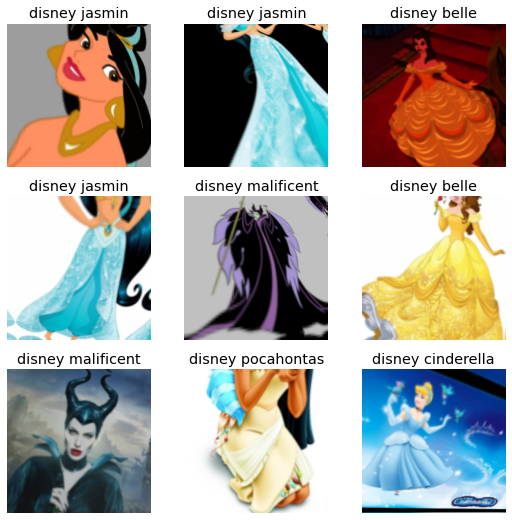

In [ ]:
dls.show_batch()

In [ ]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(4)

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


epoch,train_loss,valid_loss,error_rate,time
0,2.595319,0.974732,0.343195,00:29


epoch,train_loss,valid_loss,error_rate,time
0,1.281569,0.564789,0.224852,00:28
1,1.021536,0.332185,0.118343,00:28
2,0.805896,0.215167,0.065089,00:29
3,0.666769,0.199968,0.065089,00:29


In [ ]:
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,0.381612,0.194724,0.076923,00:28


epoch,train_loss,valid_loss,error_rate,time
0,0.319504,0.154517,0.059172,00:28
1,0.319426,0.114375,0.035503,00:29
2,0.276944,0.107262,0.023669,00:28
3,0.250968,0.114793,0.035503,00:28


In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [ ]:
count = 0
for idx in cleaner.delete(): 
  cleaner.fns[idx].unlink()
  count = count+1

print(count)

4


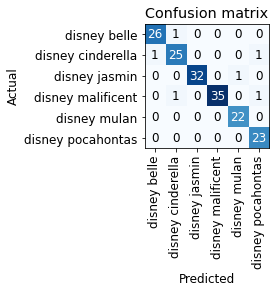

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
learn.export()

In [ ]:
btn_upload = widgets.FileUpload()
out_pl = widgets.Output()
lbl_pred = widgets.Label()

FileUpload(value={}, description='Upload')

In [ ]:
learn_inf = load_learner('export.pkl')

def on_click_classify(change):
  img = PILImage.create(btn_upload.data[-1])
  out_pl.clear_output()
  with out_pl: display(img.to_thumb(256,256))
  pred,pred_idx,probs = learn_inf.predict(img)
  lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run = widgets.Button(description='Classify')
btn_run.on_click(on_click_classify)

In [ ]:
VBox([widgets.Label('Select your disney character!'),
btn_upload, btn_run, out_pl, lbl_pred])